In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
import datetime


In [3]:
a_file = open("/home/erlend/radar.pkl", "rb")
output = pickle.load(a_file)
map_norway_lon = output.pop('lon')
map_norway_lat = output.pop('lat')
#check that dictionary is sorted 
s1 = sorted(output)
s2 = list(output.keys())
print('Output is sorted according to dates: ', s1 == s2 )

Output is sorted according to dates:  True


In [4]:
# map based on coordinates:
from global_land_mask import globe
map_norway = np.zeros(map_norway_lon.shape)
for i in range(map_norway.shape[0]):
    for j in range(map_norway.shape[1]):
        map_norway[i, j] = globe.is_land(
            map_norway_lat[i, j], map_norway_lon[i, j])

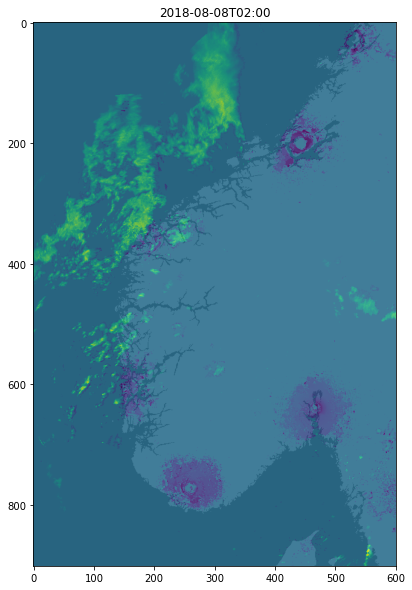

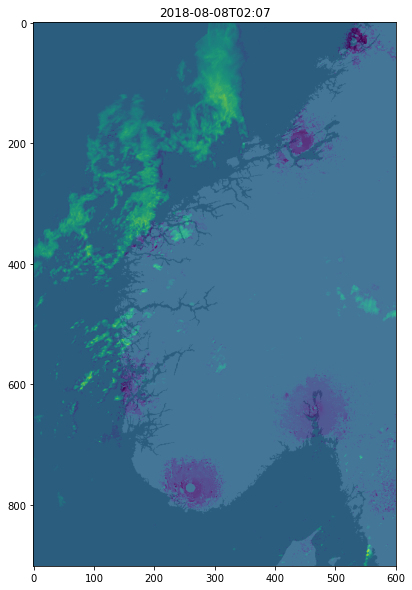

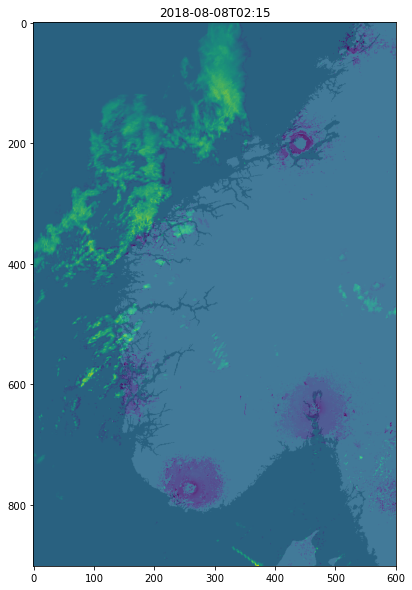

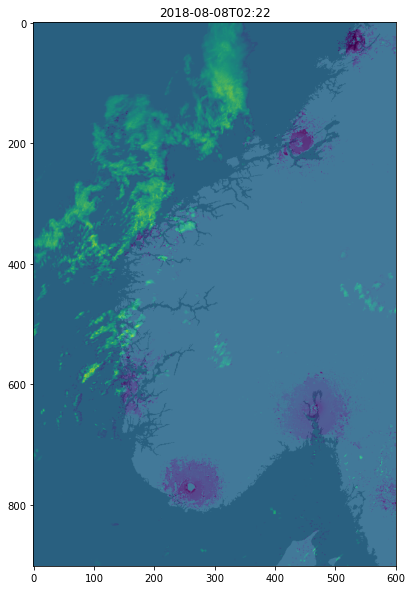

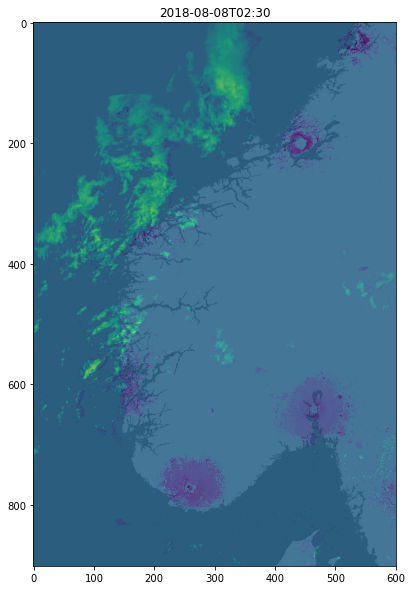

...

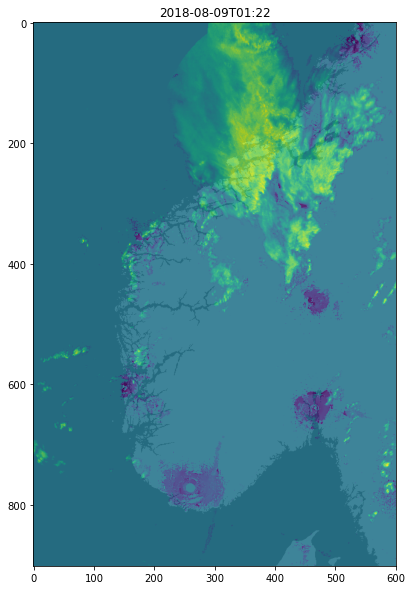

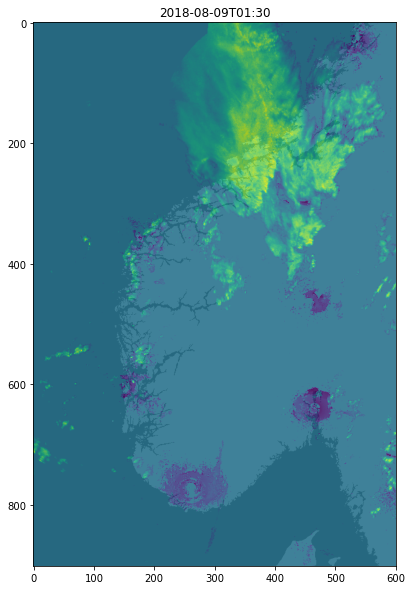

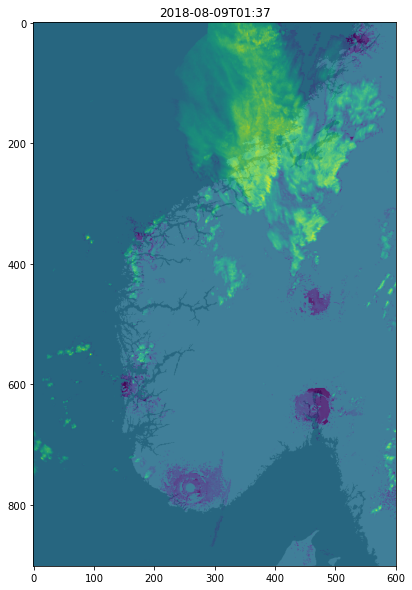

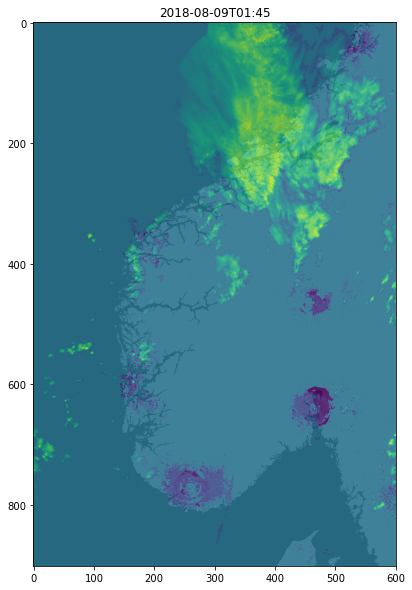

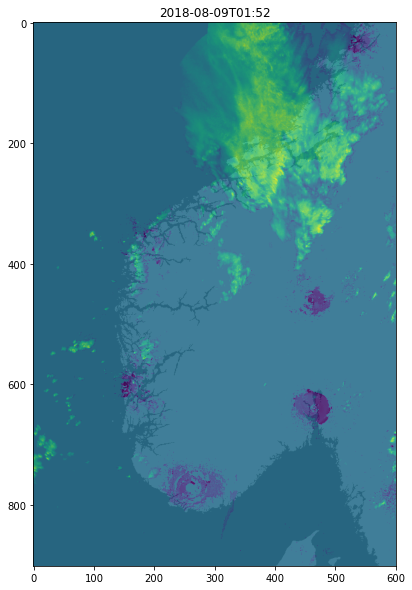

In [7]:
for timestep in output:
    
    fig, ax = plt.subplots(figsize = (10, 10))
    ax.imshow(output[timestep][0])
    ax.imshow(map_norway, alpha=0.1, cmap='gray')
    plt.title(timestep.strftime("%Y-%m-%dT%H:%M"))
    plt.show()